## This notebook is for displaying example ferengified images

In [1]:
import numpy as np
from astropy.table import Table,Column
from astropy.io import fits
import matplotlib.pyplot as plt
import bz2
import pdb
import warnings
import os.path
%matplotlib inline
from matplotlib.colors import LogNorm
import matplotlib.gridspec as gridspec
import Image
import ImageOps
from operator import itemgetter
plt.rcParams['text.usetex']=True


import urllib, cStringIO


#get galaxy filename
def image_from_file(objid,z):
    f = '99_images/{:d}_simz_{:d}_evo_1.jpg'.format(objid,z)
    img = Image.open(f)

    return img
#function for getting galaxy images
def image_from_url(gal):
    
    pixelsize=0.396
    height=500
    width=500

    scale=2.5*gal['petror90_r']/pixelsize/width
    # form wurl to query SDSS web sevice to generate cutout image
    cutOutImageUrl="http://skyservice.pha.jhu.edu/DR12/ImgCutout/getjpeg.aspx?ra=" + str(gal['RA'])
    cutOutImageUrl += "&dec=" + str(gal['DEC']) + "&scale=""" + str(scale) + "&width=" + str(width)
    cutOutImageUrl += "&height=" + str(height)
    
    file = cStringIO.StringIO(urllib.urlopen(cutOutImageUrl).read())
    img = Image.open(file)    
    return img


In [2]:
data = Table.read('example_galaxies_99.fits')

In [3]:
data[0]

dr12objid,image_url,rowc_r,colc_r,redshift,p_features,MU50_R,morph_type,RA,DEC,petror90_r
int64,str147,float64,float64,float64,float32,float64,str9,float64,float64,float64
1237661068171673641,http://skyservice.pha.jhu.edu/DR7/ImgCutout/getjpeg.aspx?ra=143.5116&dec=10.10871&scale=0.25&width=512&height=512&opt=GL&query=&Grid=on&Label=on,318.5216,408.6764,0.01049027,0.856,18.2839889526,hi_p,143.5116,10.10871,16.2844


In [4]:
morph_types=list(set(data['morph_type'])) #get list of morphology bins
morph_types


['mid_hi_p ', 'hi_p     ', 'low_p    ', 'low_mid_p']

In [5]:
low_p = data[data['morph_type']==morph_types[2]] #low p_features
low_p_list=[] #put in list so data can be sorted by whatever 
for gal in low_p:
    low_p_list.append(gal)
low_p_list.sort(key=itemgetter(data.colnames.index('MU50_R'))) #sort by mu

low_mid_p = data[data['morph_type']==morph_types[3]] #low/mid p_features
low_mid_p_list=[] #put in list so data can be sorted by whatever 
for gal in low_mid_p:
    low_mid_p_list.append(gal)
low_mid_p_list.sort(key=itemgetter(data.colnames.index('MU50_R'))) #sort by mu

mid_hi_p = data[data['morph_type']==morph_types[0]] #mid/hi p_features
mid_hi_p_list=[] #put in list so data can be sorted by whatever 
for gal in mid_hi_p:
    mid_hi_p_list.append(gal)
mid_hi_p_list.sort(key=itemgetter(data.colnames.index('MU50_R'))) #sort by mu

hi_p = data[data['morph_type']==morph_types[1]] #hi p_features
hi_p_list=[] #put in list so data can be sorted by whatever 
for gal in hi_p:
    hi_p_list.append(gal)
hi_p_list.sort(key=itemgetter(data.colnames.index('MU50_R'))) #sort by mu

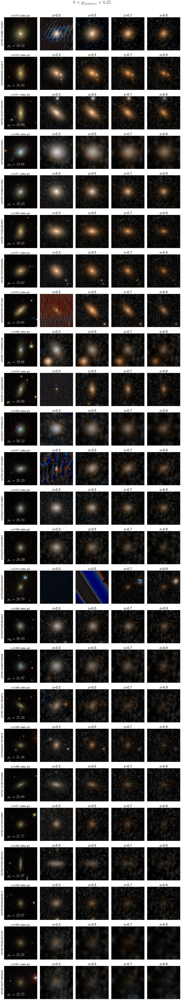

In [80]:
zs = [3,5,7,9]
f = plt.figure(figsize=(20,110))
gs = gridspec.GridSpec(25,5)
gs.update(wspace=0.01)

for j in range(0,len(low_p_list)):
    gal = low_p_list[j]
    #first cell: original image
    ax = plt.subplot(gs[j,0])
    plt.imshow(image_from_url(gal))

    plt.tick_params(labelleft='off',labelbottom='off')
    plt.title('z={:.3f} (sdss gri)'.format(gal['redshift']),fontsize=15)
    ax.text(.1,.08,r'$\mu_r={:.2f}$'.format(gal['MU50_R']),fontsize=25,color='w',transform=ax.transAxes)
    plt.ylabel('{:d}'.format(gal['dr12objid']),fontsize=15)

    #next: ferengified images at z=0.3, 0.5, 0.7, and 0.9
    for i,z in enumerate(zs):
        ax = plt.subplot(gs[j,i+1])
        plt.imshow(image_from_file(gal['dr12objid'],z))
        plt.tick_params(labelleft='off',labelbottom='off')
        plt.title('z=0.{:d}'.format(z),fontsize=20)
f.text(.43,.91,'$0<p_{features}<0.25$',fontsize=30)
        
plt.savefig('ferengi_low_p_features.pdf')

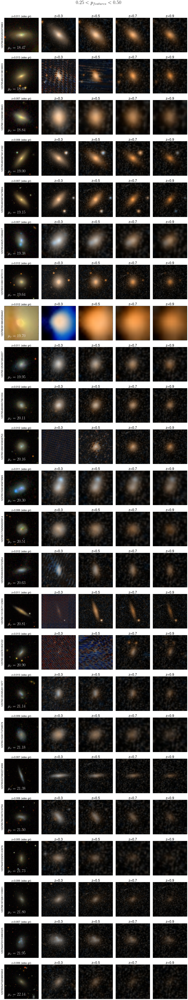

In [87]:
zs = [3,5,7,9]
f = plt.figure(figsize=(20,110))
gs = gridspec.GridSpec(25,5)
gs.update(wspace=0.01)

for j in range(0,len(low_mid_p_list)):
    gal = low_mid_p_list[j]
    #first cell: original image
    ax = plt.subplot(gs[j,0])
    plt.imshow(image_from_url(gal))

    plt.tick_params(labelleft='off',labelbottom='off')
    plt.title('z={:.3f} (sdss gri)'.format(gal['redshift']),fontsize=15)
    ax.text(.1,.08,r'$\mu_r={:.2f}$'.format(gal['MU50_R']),fontsize=25,color='w',transform=ax.transAxes)
    plt.ylabel('{:d}'.format(gal['dr12objid']),fontsize=15)

    #next: ferengified images at z=0.3, 0.5, 0.7, and 0.9
    for i,z in enumerate(zs):
        ax = plt.subplot(gs[j,i+1])
        plt.imshow(image_from_file(gal['dr12objid'],z))
        plt.tick_params(labelleft='off',labelbottom='off')
        plt.title('z=0.{:d}'.format(z),fontsize=20)
f.text(.43,.91,'$0.25<p_{features}<0.50$',fontsize=30)
        
plt.savefig('ferengi_low_mid_p_features.pdf')

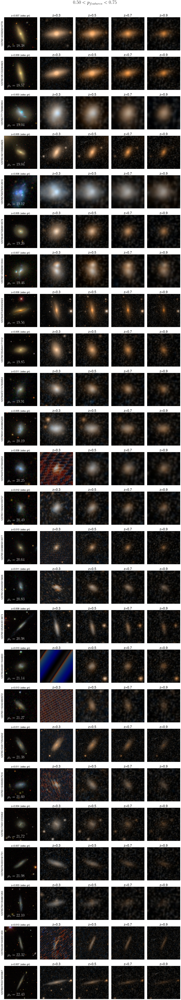

In [88]:
zs = [3,5,7,9]
f = plt.figure(figsize=(20,110))
gs = gridspec.GridSpec(25,5)
gs.update(wspace=0.01)

for j in range(0,len(mid_hi_p_list)):
    gal = mid_hi_p_list[j]
    #first cell: original image
    ax = plt.subplot(gs[j,0])
    plt.imshow(image_from_url(gal))

    plt.tick_params(labelleft='off',labelbottom='off')
    plt.title('z={:.3f} (sdss gri)'.format(gal['redshift']),fontsize=15)
    ax.text(.1,.08,r'$\mu_r={:.2f}$'.format(gal['MU50_R']),fontsize=25,color='w',transform=ax.transAxes)
    plt.ylabel('{:d}'.format(gal['dr12objid']),fontsize=15)

    #next: ferengified images at z=0.3, 0.5, 0.7, and 0.9
    for i,z in enumerate(zs):
        ax = plt.subplot(gs[j,i+1])
        plt.imshow(image_from_file(gal['dr12objid'],z))
        plt.tick_params(labelleft='off',labelbottom='off')
        plt.title('z=0.{:d}'.format(z),fontsize=20)
f.text(.43,.91,'$0.50<p_{features}<0.75$',fontsize=30)
        
plt.savefig('ferengi_mid_hi_p_features.pdf')

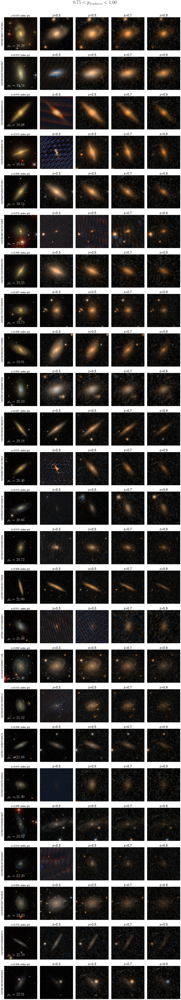

In [89]:
zs = [3,5,7,9]
f = plt.figure(figsize=(20,110))
gs = gridspec.GridSpec(25,5)
gs.update(wspace=0.01)

for j in range(0,len(hi_p_list)):
    gal = hi_p_list[j]
    #first cell: original image
    ax = plt.subplot(gs[j,0])
    plt.imshow(image_from_url(gal))

    plt.tick_params(labelleft='off',labelbottom='off')
    plt.title('z={:.3f} (sdss gri)'.format(gal['redshift']),fontsize=15)
    ax.text(.1,.08,r'$\mu_r={:.2f}$'.format(gal['MU50_R']),fontsize=25,color='w',transform=ax.transAxes)
    plt.ylabel('{:d}'.format(gal['dr12objid']),fontsize=15)

    #next: ferengified images at z=0.3, 0.5, 0.7, and 0.9
    for i,z in enumerate(zs):
        ax = plt.subplot(gs[j,i+1])
        plt.imshow(image_from_file(gal['dr12objid'],z))
        plt.tick_params(labelleft='off',labelbottom='off')
        plt.title('z=0.{:d}'.format(z),fontsize=20)
f.text(.43,.91,'$0.75<p_{features}<1.00$',fontsize=30)
        
plt.savefig('ferengi_hi_p_features.pdf')

In [3]:
failed_objids = [1237651249881153539,1237648720673767456,1237651212286230593,
                1237651225710034980,1237653586333925387,1237654601019818003,
                 1237651298185838753,1237656906350723254,1237651191357112369,
                 1237651226781352122,1237648704576946202,1237651249885610077,
                 1237651250435915836,1237654948911644830,1237651192424890572,
                 1237651194568507516,1237654391640031459,1237665226766483567,
                 1237658493888430103,1237648722290606136,1237654601557213384,
                 1237648673971437623,1237650370481029219,1237648704046563336,
                 1237651189746892897,1237654670810546312,1237655108376199345,
                 1237662224076046407]

In [4]:
for obj in failed_objids:
     if obj not in data['dr12objid']:
            print obj

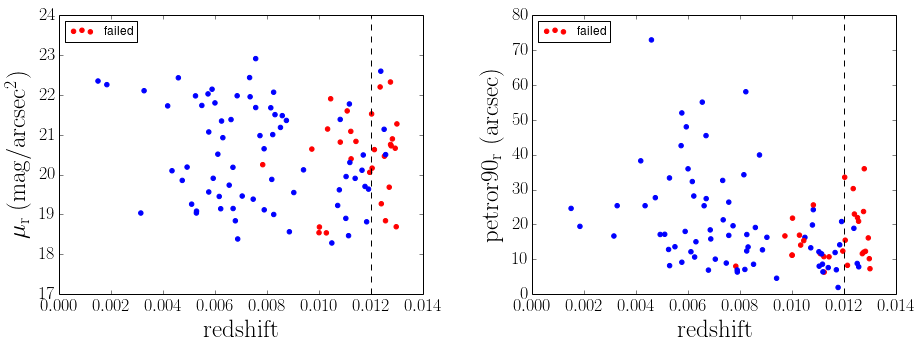

In [20]:
plt.rcParams['xtick.labelsize'] = 18
plt.rcParams['ytick.labelsize'] = 18 

f=plt.figure(figsize=(15,5))
gs=gridspec.GridSpec(1,2,width_ratios=[1,1])
gs.update(wspace=.3)
ax=plt.subplot(gs[0,0])
for gal in data:
    objid = gal['dr12objid']
    if objid in failed_objids:
        plt.scatter(gal['redshift'],gal['MU50_R'],color='r')
        if objid ==failed_objids[0]:
            plt.scatter(gal['redshift'],gal['petror90_r'],color='r',label='failed')

    else:
        plt.scatter(gal['redshift'],gal['MU50_R'],color='b')
plt.xlabel('$\mathrm{redshift}$',fontsize=25)
plt.ylabel('$\mathrm{\mu_r~(mag/arcsec^2)}$',fontsize=25)
plt.axvline(x=0.012,ls='dashed',c='k')
plt.legend(loc=2)
plt.ylim(17,24)

ax=plt.subplot(gs[0,1])
for gal in data:
    objid = gal['dr12objid']
    if objid in failed_objids:
        plt.scatter(gal['redshift'],gal['petror90_r'],color='r')
        if objid ==failed_objids[0]:
            plt.scatter(gal['redshift'],gal['petror90_r'],color='r',label='failed')
    else:
        plt.scatter(gal['redshift'],gal['petror90_r'],color='b')
plt.xlabel('$\mathrm{redshift}$',fontsize=25)
plt.ylabel('$\mathrm{petror90_r~(arcsec)}$',fontsize=25)
plt.axvline(x=0.012,ls='dashed',c='k')
plt.legend(loc=2)
plt.ylim(0,80)
plt.savefig('FAIL.pdf')

In [19]:
data3 = data[(data['dr12objid']==1237648720698671128) | (data['dr12objid']==1237648704056328322) | (data['dr12objid']==1237651538708332609)]
from scipy import ndimage


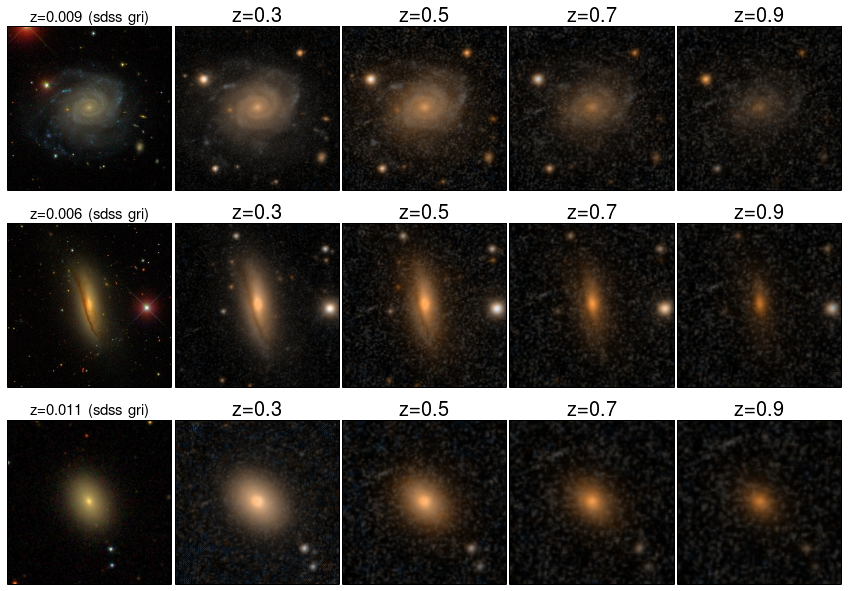

In [26]:
#example images for blog
zs = [3,5,7,9]
f = plt.figure(figsize=(15,10))
gs = gridspec.GridSpec(3,5)
gs.update(wspace=0.0)

for j in range(0,len(data3)):
    gal = data3[j]
    #first cell: original image
    ax = plt.subplot(gs[j,0])
    img = image_from_url(gal)
    rot_image = ndimage.rotate(img,270)
    plt.imshow(rot_image)

    plt.tick_params(labelleft='off',labelbottom='off')
    plt.title('z={:.3f} (sdss gri)'.format(gal['redshift']),fontsize=15)

    #next: ferengified images at z=0.3, 0.5, 0.7, and 0.9
    for i,z in enumerate(zs):
        ax = plt.subplot(gs[j,i+1])
        plt.imshow(image_from_file(gal['dr12objid'],z))
        plt.tick_params(labelleft='off',labelbottom='off')
        plt.title('z=0.{:d}'.format(z),fontsize=20)
        
plt.savefig('/home/mel/Documents/thesis/figures/ferengi2_examples.pdf')

In [6]:
#example of failed galaxies for thesis

In [21]:
datafail = data[(data['dr12objid']==1237654601019818003) | (data['dr12objid']==1237665226766483567)]
from scipy import ndimage


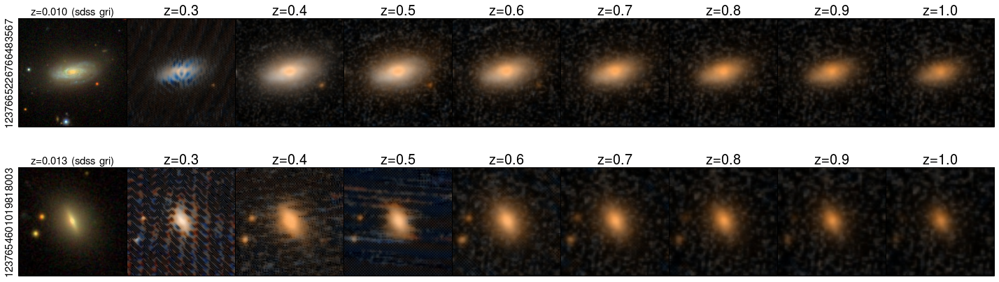

In [25]:
#example images for thesis
zs = [3,4,5,6,7,8,9,10]
f = plt.figure(figsize=(25,7))
gs = gridspec.GridSpec(2,9)
gs.update(wspace=0.0)

for j in range(0,len(datafail)):
    gal = datafail[j]
    #first cell: original image
    ax = plt.subplot(gs[j,0])
    img = image_from_url(gal)
    rot_image = ndimage.rotate(img,270)
    plt.imshow(rot_image)

    plt.tick_params(labelleft='off',labelbottom='off')
    plt.title('z={:.3f} (sdss gri)'.format(gal['redshift']),fontsize=15)
    plt.ylabel('{:d}'.format(gal['dr12objid']),fontsize=15)

    #next: ferengified images at z=0.3, 0.5, 0.7, and 0.9
    for i,z in enumerate(zs):
        ax = plt.subplot(gs[j,i+1])
        plt.imshow(image_from_file(gal['dr12objid'],z))
        plt.tick_params(labelleft='off',labelbottom='off')
        plt.title('z={}'.format(z/10.),fontsize=20)
        
plt.savefig('/home/mel/Documents/thesis/figures/failed_ferengis.pdf')

In [16]:
len(datafail)

2